## Introduction

The purpose of this document is to illustrate the steps we followed to compute [RED](http://www.red.com/) colourspaces primaries.

The most important attribute used to specify an [RGB colourspace](http://en.wikipedia.org/wiki/RGB_color_space) is the set of 3 chromaticities or primaries encompassing the [gamut](http://en.wikipedia.org/wiki/Gamut) of colours that the *RGB* colourspace can represent.

A convenient way to view an *RGB* colourspace gamut is to project it onto a [chromaticity diagram](http://en.wikipedia.org/wiki/Chromaticity) such as the *CIE 1931 Chromaticity Diagram* where the primaries define the triangle encompassing the gamut.

In [1]:
% matplotlib inline

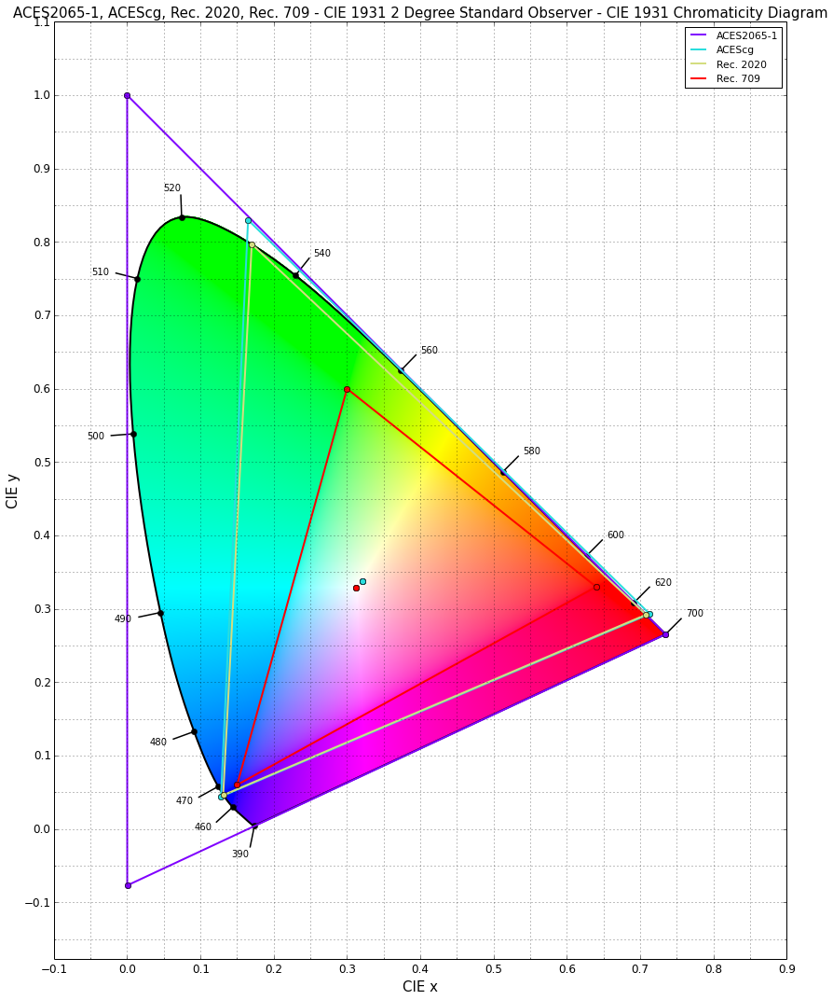

True

In [2]:
import numpy as np
import warnings

import colour
from colour.plotting import *

warnings.simplefilter("ignore")

# Plotting a few selected *RGB* colourspaces in 
# *CIE 1931 Chromaticity Diagram*.
RGB_colourspaces_CIE_1931_chromaticity_diagram_plot(
    ['ACES2065-1', 'ACEScg', 'Rec. 2020', 'Rec. 709'])

There have been some notable efforts by [VideoVillage](http://lattice.videovillage.co/) to solve through image analysis the various *RED* colourspaces primaries as suggested in this [CocoaLUT](https://github.com/videovillage/CocoaLUT/commit/675d6a82b48989dfafb5e5d4021639a44ce095e7) commit.

We present in this document an improved set of primaries for the following *RED* colourspaces:

- *DRAGONcolor*
- *DRAGONcolor2*
- *REDcolor*
- *REDcolor2*
- *REDcolor3*
- *REDcolor4*

## Methodology

*RED* has recently publicised various *RED* colourspaces to *ACES2065-1* colourspace conversion matrices, which are available in the [OpenColorIO-Configs](https://github.com/hpd/OpenColorIO-Configs/blob/master/aces_1.0.0/python/aces_ocio/create_red_colorspaces.py) repository.

We will use those matrices and some free online RED footage ([videoandfilmmaker](http://videoandfilmmaker.com/wp/index.php/news/red-epic-dragon-6k-footage-available-test-editing/), [iris32](http://download.iris32.com/media/5720b308c92ac21842876c02bcfc95ec.html), [cinematography.net](http://www.cinematography.net/match/A007_L006_0101RQ.0000000F.R3D)) to respectively perform and validate the various *RED* colourspaces primaries computations.

### Normalised Primary Matrix to Primaries & Whitepoint

Computing the primaries and whitepoint of a given *RGB* colourspace is possible if the *normalised primary matrix* converting *RGB* values to *CIE XYZ* tristimulus values is known. <a name="back_reference_1"></a><a href="#reference_1">[1]</a>

The primaries *CIE XYZ* tristimulus values are calculated as follows:

$$
\begin{equation}
XYZ_P = (M_{npm}\cdot I)^T
\end{equation}
$$

where $M_{npm}$ is the 3x3 *normalised primary matrix* of the *RGB* colourspace and $I$ is a 3x3 identity matrix.

The whitepoint *CIE XYZ* tristimulus values are calculated as follows:

$$
\begin{equation}
XYZ_W = (M_{npm}\cdot O)^T
\end{equation}
$$

where $O$ is a 3x1 ones filled matrix such as $O = [1, 1, 1]$.

The final step is to convert $XYZ_P$ and $XYZ_W$ *CIE XYZ* tristimulus values to *xy* chromaticity coordinates:

$$
\begin{equation}
xy_P = XYZ\_to\_xy(XYZ_P)\\
xy_W = XYZ\_to\_xy(XYZ_W)
\end{equation}
$$

where $XYZ\_to\_xy$ function equations are expressed as follows:

$$
\begin{equation}
x = \cfrac{X}{X+Y+Z}\\
y = \cfrac{Y}{X+Y+Z}
\end{equation}
$$

[Colour](https://github.com/colour-science/colour/) implements the *colour.primaries_whitepoint* definition to compute the primaries and whitepoint from a given *RGB* colourspace *normalised primary matrix*:

In [3]:
# Computing *ACES2065-1* primaries and whitepoint.
npm = np.array([[9.52552396e-01, 0.00000000e+00, 9.36786317e-05],
                [3.43966450e-01, 7.28166097e-01, -7.21325464e-02],
                [0.00000000e+00, 0.00000000e+00, 1.00882518e+00]])

print(colour.primaries_whitepoint(npm))
print(colour.RGB_COLOURSPACES['ACES2065-1'].primaries)
print(colour.RGB_COLOURSPACES['ACES2065-1'].whitepoint)

(array([[  7.34700000e-01,   2.65300000e-01],
       [  0.00000000e+00,   1.00000000e+00],
       [  1.00000001e-04,  -7.70000004e-02]]), array([ 0.32168,  0.33767]))
[[  7.34700000e-01   2.65300000e-01]
 [  0.00000000e+00   1.00000000e+00]
 [  1.00000000e-04  -7.70000000e-02]]
(0.32168, 0.33767)


### RGB to RGB Matrix to Normalised Primary Matrix

Given $M_{RED\rightarrow RGB}$, the publicised *RED* colourspace to *ACES2065-1* colourspace matrix, and $M_{XYZ\rightarrow RGB}$ the known *CIE XYZ* colourspace to *ACES2065-1* colourspace matrix, converting from *CIE XYZ* tristimulus values to *RED* colourspace is expressed by this equation:

$$
\begin{equation}
RGB_{RED} = M_{RED\rightarrow RGB}^{-1}\cdot(M_{XYZ\rightarrow RGB}\cdot XYZ)
\end{equation}
$$

which can be rewritten as follows:

$$
\begin{equation}
RGB_{RED} = M_{XYZ\rightarrow RED}\cdot XYZ
\end{equation}
$$

where $M_{XYZ\rightarrow RED}$ is the inverse of the $M_{npm}$ *normalised primary matrix* we would like to solve for, thus:

$$
\begin{equation}
RGB_{RED} = M_{npm}^{-1}\cdot XYZ
\end{equation}
$$

It is possible to solve for $M_{npm}^{-1}$ by replacing the 3x1 $XYZ$ matrix with a 3x3 identity matrix $I$ such as:

$$
\begin{equation}
M_{npm}^{-1} = M_{RED\rightarrow RGB}^{-1}\cdot(M_{XYZ\rightarrow RGB}\cdot I)
\end{equation}
$$

## Implementation

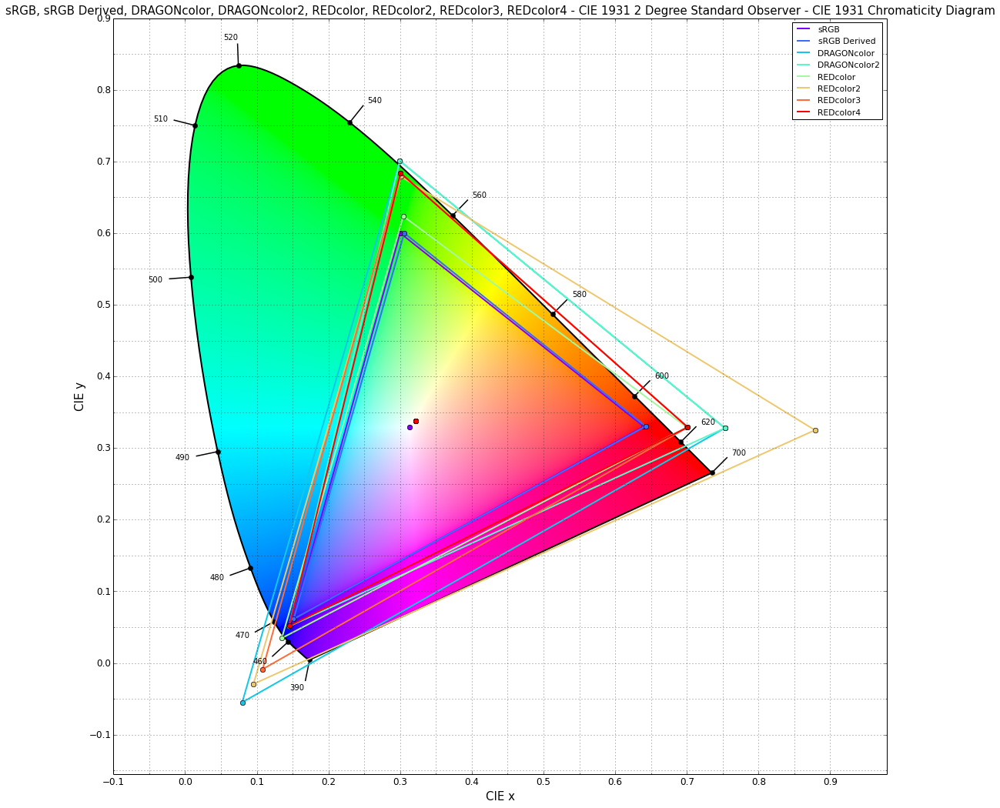

True

In [4]:
DRAGONCOLOR_TO_ACES_2065_1 = np.array(
    [[0.532279, 0.376648, 0.091073],
     [0.046344, 0.974513, -0.020860],
     [-0.053976, -0.000320, 1.054267]])

DRAGONCOLOR2_TO_ACES_2065_1 = np.array(
    [[0.468452, 0.331484, 0.200064],
     [0.040787, 0.857658, 0.101553],
     [-0.047504, -0.000282, 1.047756]])

REDCOLOR_TO_ACES_2065_1 = np.array(
    [[0.451464, 0.388498, 0.160038],
     [0.062716, 0.866790, 0.070491],
     [-0.017541, 0.086921, 0.930590]])

REDCOLOR2_TO_ACES_2065_1 = np.array(
    [[0.480997, 0.402289, 0.116714],
     [-0.004938, 1.000154, 0.004781],
     [-0.105257, 0.025320, 1.079907]])

REDCOLOR3_TO_ACES_2065_1 = np.array(
    [[0.512136, 0.360370, 0.127494],
     [0.070377, 0.903884, 0.025737],
     [-0.020824, 0.017671, 1.003123]])

REDCOLOR4_TO_ACES_2065_1 = np.array(
    [[0.474202, 0.333677, 0.192121],
     [0.065164, 0.836932, 0.097901],
     [-0.019281, 0.016362, 1.002889]])

ACES2065_1_TO_sRGB = np.array(
    [[2.5217167, -1.1341655, -0.3875512],
     [-0.276476, 1.3727113, -0.0962348],
     [-0.015382, -0.1529940, 1.1683768]])

RED_TO_ACES_2065_1_MATRICES = {
    'DRAGONcolor': DRAGONCOLOR_TO_ACES_2065_1,
    'DRAGONcolor2': DRAGONCOLOR2_TO_ACES_2065_1,
    'REDcolor': REDCOLOR_TO_ACES_2065_1,
    'REDcolor2': REDCOLOR2_TO_ACES_2065_1,
    'REDcolor3': REDCOLOR3_TO_ACES_2065_1,
    'REDcolor4': REDCOLOR4_TO_ACES_2065_1}


def RGB_to_RGB_matrix_to_normalised_primary_matrix(RGB_to_RGB_matrix,
                                                   XYZ_to_RGB_matrix):
    M = np.einsum('...ij,...jk->...ik', XYZ_to_RGB_matrix, np.identity(3))
    M = np.einsum('...ij,...jk->...ik', RGB_to_RGB_matrix, M)

    M = np.linalg.inv(M)

    return M


def RED_colourspaces_derivation():
    RED_colourspaces = {}
    for name, RGB_to_RGB_matrix in RED_TO_ACES_2065_1_MATRICES.items():
        NPM = RGB_to_RGB_matrix_to_normalised_primary_matrix(
            np.linalg.inv(RGB_to_RGB_matrix),
            colour.RGB_COLOURSPACES['ACES2065-1'].XYZ_to_RGB_matrix)

        P, W = colour.primaries_whitepoint(NPM)

        RED_colourspaces[name] = colour.RGB_Colourspace(
            name,
            primaries=P,
            whitepoint=W,
            illuminant='D60',
            RGB_to_XYZ_matrix=NPM,
            XYZ_to_RGB_matrix=np.linalg.inv(NPM))
    return RED_colourspaces


RED_COLOURSPACES = RED_colourspaces_derivation()
colour.RGB_COLOURSPACES.update(RED_COLOURSPACES)

# Computing a derived *sRGB* colourspace as methodology 
# validation. Notice that the derived primaries are not exactly
# the same, which is likely to be the result of the input 
# matrices being rounded and chromatic adaptation precision.
NPM = RGB_to_RGB_matrix_to_normalised_primary_matrix(
    ACES2065_1_TO_sRGB,
    colour.RGB_COLOURSPACES['ACES2065-1'].XYZ_to_RGB_matrix)
P, W = colour.primaries_whitepoint(NPM)
colour.RGB_COLOURSPACES['sRGB Derived'] = colour.RGB_Colourspace(
    'sRGB Derived',
    primaries=P,
    whitepoint=W)

RGB_colourspaces_CIE_1931_chromaticity_diagram_plot(
    ['sRGB', 'sRGB Derived'] + sorted(RED_COLOURSPACES.keys()))

## Analysis

Analysis of the various *RED* colourspaces primaries performance is done by converting a *CIE XYZ* reference image to the various *RED* colourspaces using our set of primaries and the VideoVillage ones and comparing those outputs to the native [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/) *R3D* reader output.

> Note: The derived whitepoint is *D60* because it is the one used by *ACES2065-1* colourspace specification.

### Nuke R3D Reader CIE XYZ Reference

The *CIE XYZ Reference* images below have been generated within [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/) using the following *Read* node settings:

- decode resolution: EighthGood
- color space: REDcolor3
- gamma space: Half Float Linear

The publicised *REDcolor3* colourspace to *ACES2065-1* colourspace matrix and [the known matrix](https://github.com/colour-science/colour/blob/develop/colour/models/dataset/aces.py#L135) converting from *ACES2065-1* colourspace to *CIE XYZ* colourspace were used to convert from *REDcolor3* colourspace to *CIE XYZ* colourspace.

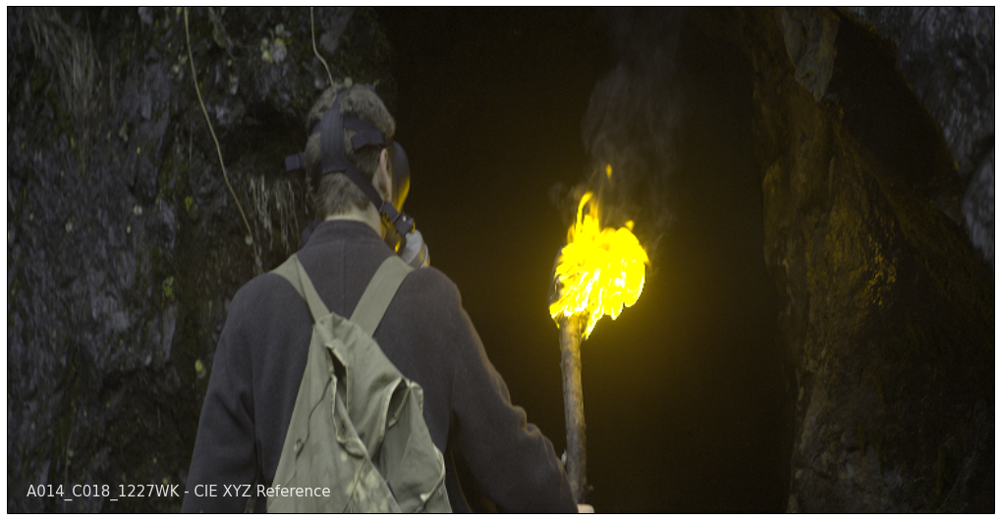

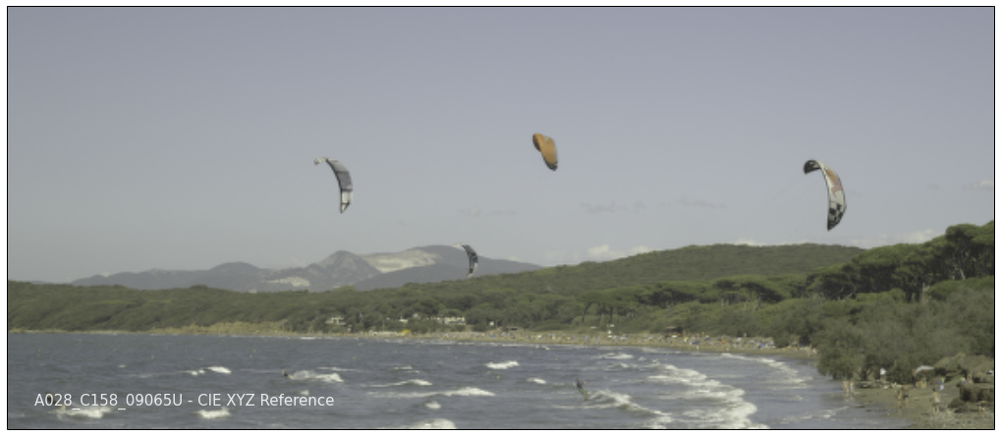

In [5]:
IMAGES_BASENAME = ('A014_C018_1227WK', 'A028_C158_09065U')

OECF = colour.RGB_COLOURSPACES['sRGB'].transfer_function

for basename in IMAGES_BASENAME:
    image_plot(OECF(colour.read_image(
    'resources/images/red/{0}_XYZ.exr'.format(basename))),
               label='{0} - CIE XYZ Reference'.format(basename))

### REDcolor Colourspace RMSE

The *REDcolor Reference* images below have been generated within [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/) using the following *Read* node settings:

- decode resolution: EighthGood
- color space: REDcolor
- gamma space: Half Float Linear

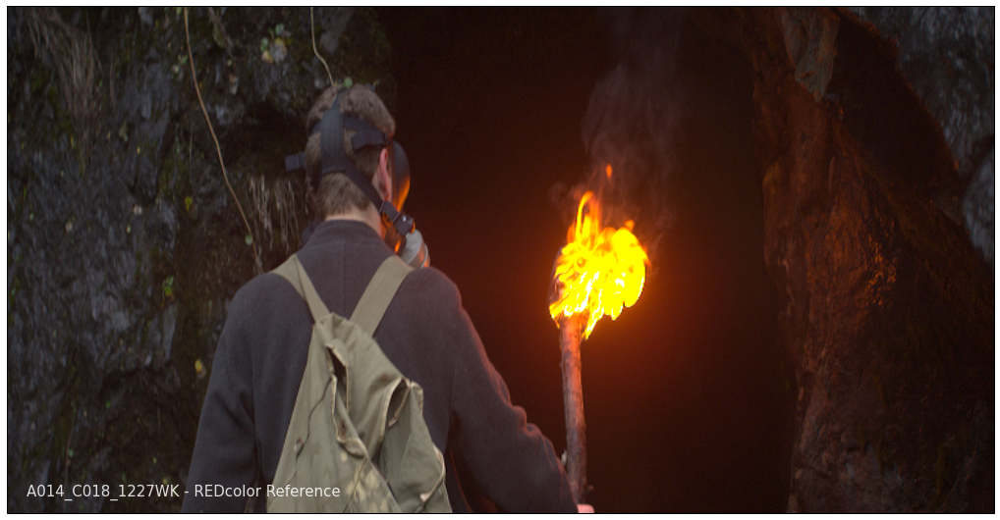

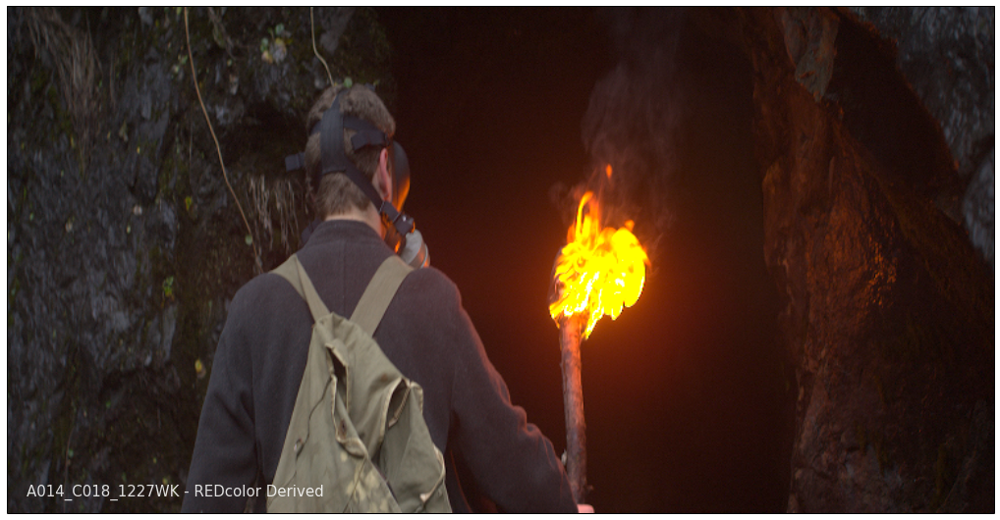

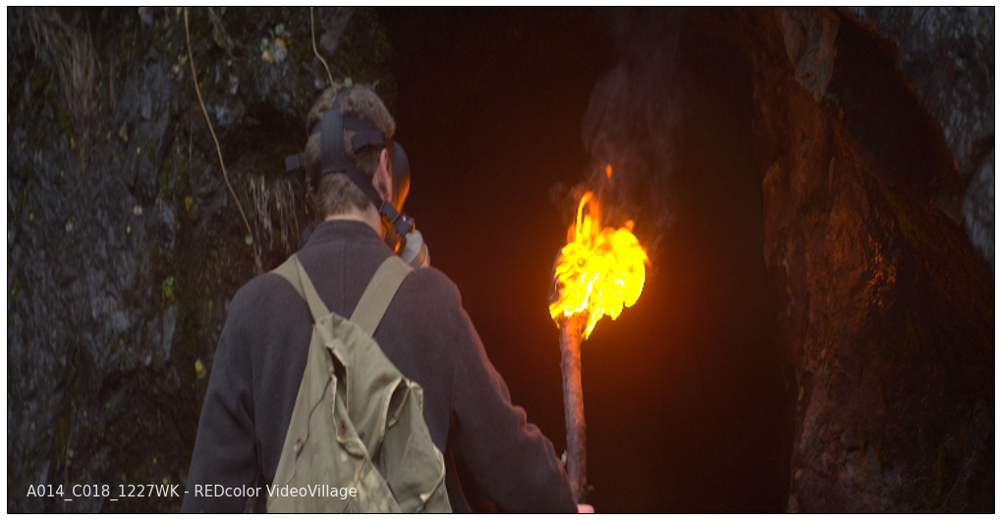

*                                                                             *
*   A014_C018_1227WK                                                          *
*                                                                             *
*   rmse   : 0.0173276638845                                                  *
*                                                                             *
*   rmse VV: 0.0346438717883                                                  *
*                                                                             *




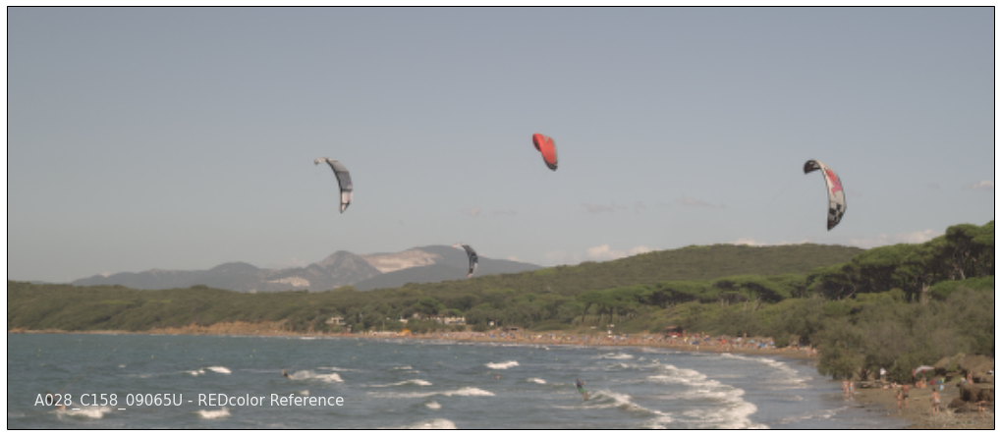

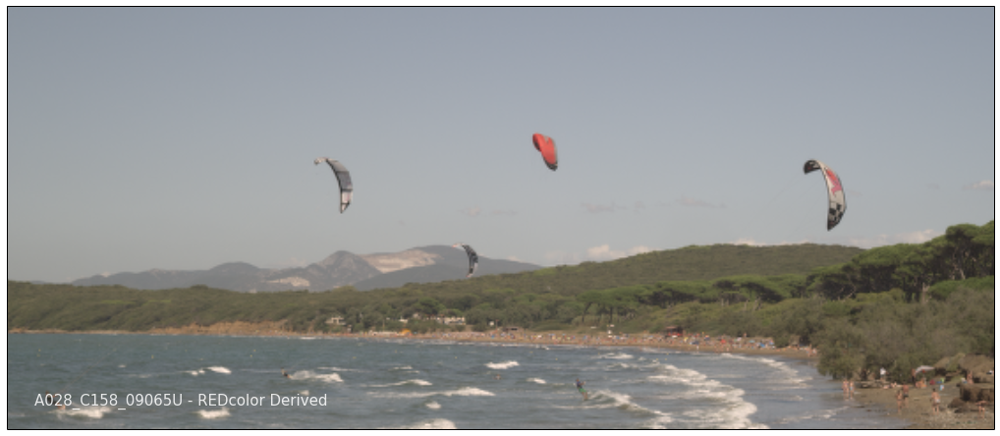

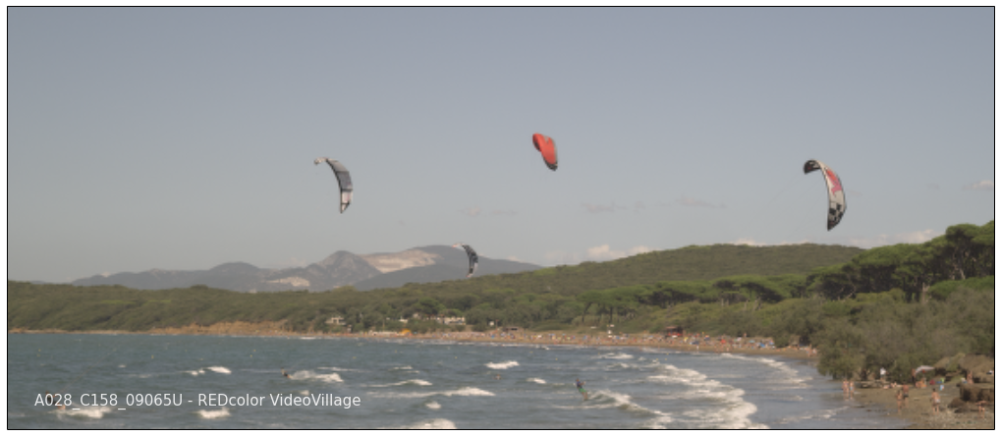

*                                                                             *
*   A028_C158_09065U                                                          *
*                                                                             *
*   rmse   : 0.000163671833746                                                *
*                                                                             *
*   rmse VV: 0.00139640043017                                                 *
*                                                                             *




In [6]:
D60 = colour.ILLUMINANTS['cie_2_1931']['D60']

# *VideoVillage* set of primaries solved through
# image analysis and used for comparison.
VV_PRIMARIES = {
    'REDcolor': np.array([
        [0.682235759294, 0.320973856307],
        [0.295705729612, 0.613311106957],
        [0.134524597085, 0.034410956920]]),
    'REDcolor2': np.array([
        [0.858485322390, 0.316594954144],
        [0.292084791425, 0.667838655872],
        [0.097651412967, 0.026565653796]]),
    'REDcolor3': np.array([
        [0.682450885401, 0.320302618634],
        [0.291813306036, 0.672642663443],
        [0.109533374066, 0.006916855752]]),
    'REDcolor4': np.array([
        [0.682432347, 0.320314427],
        [0.291815909, 0.672638769],
        [0.144290202, 0.050547336]]),
    'DRAGONcolor': np.array([
        [0.733696621349, 0.319213119879],
        [0.290807268864, 0.689667987865],
        [0.083009416684, 0.050780628080]]),
    'DRAGONcolor2': np.array([
        [0.733671536367, 0.319227712042],
        [0.290804815281, 0.689668775507],
        [0.143989704285, 0.050047743857]])}


def RGB_colourspace_RMSE(colourspace):
    for basename in IMAGES_BASENAME:
        XYZ_image = colour.read_image(
            'resources/images/red/{0}_XYZ.exr'.format(basename))

        RGB_image = colour.read_image(
            'resources/images/red/{0}_{1}.exr'.format(basename,
                                                      colourspace))

        RGB_image_d = colour.XYZ_to_RGB(
            XYZ_image,
            D60,
            colour.RGB_COLOURSPACES[colourspace].whitepoint,
            colour.RGB_COLOURSPACES[colourspace].XYZ_to_RGB_matrix)

        rmse = np.std(np.ravel(RGB_image - RGB_image_d))

        npm_vv = colour.normalised_primary_matrix(
            VV_PRIMARIES[colourspace], D60)

        RGB_image_vv = colour.XYZ_to_RGB(
            XYZ_image,
            D60,
            D60,
            np.linalg.inv(npm_vv))

        rmse_vv = np.std(np.ravel(RGB_image - RGB_image_vv))

        image_plot(OECF(RGB_image),
                   label='{0} - {1} Reference'.format(basename,
                                                      colourspace))
        image_plot(OECF(RGB_image_d),
                   label='{0} - {1} Derived'.format(basename,
                                                    colourspace))
        image_plot(OECF(RGB_image_vv),
                   label='{0} - {1} VideoVillage'.format(basename,
                                                         colourspace))

        colour.message_box(('{0}\n\n'
                            'rmse   : {1}\n\n'
                            'rmse VV: {2}').format(basename, rmse, rmse_vv))

        print('\n')


RGB_colourspace_RMSE('REDcolor')

### REDcolor2 Colourspace RMSE

The *REDcolor2 Reference* images below have been generated within [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/) using the following *Read* node settings:

- decode resolution: EighthGood
- color space: REDcolor2
- gamma space: Half Float Linear

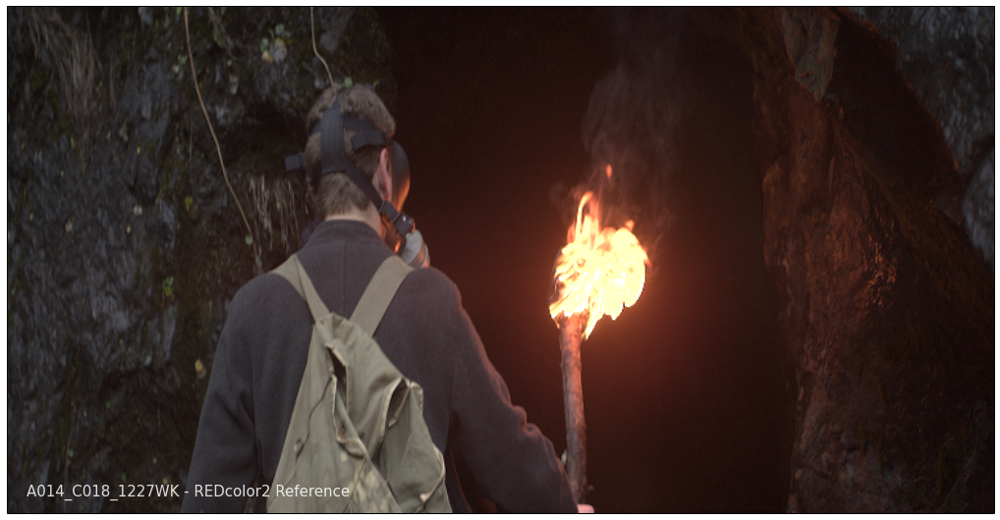

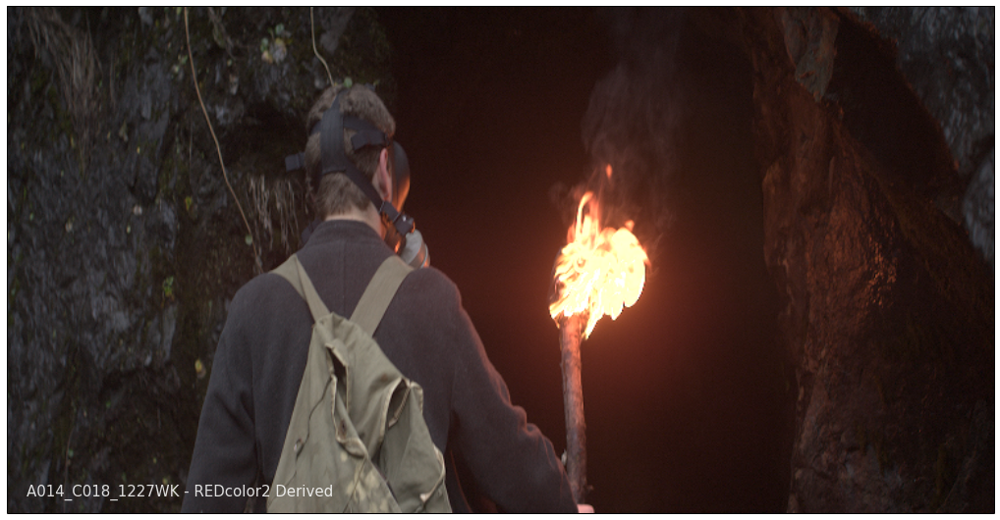

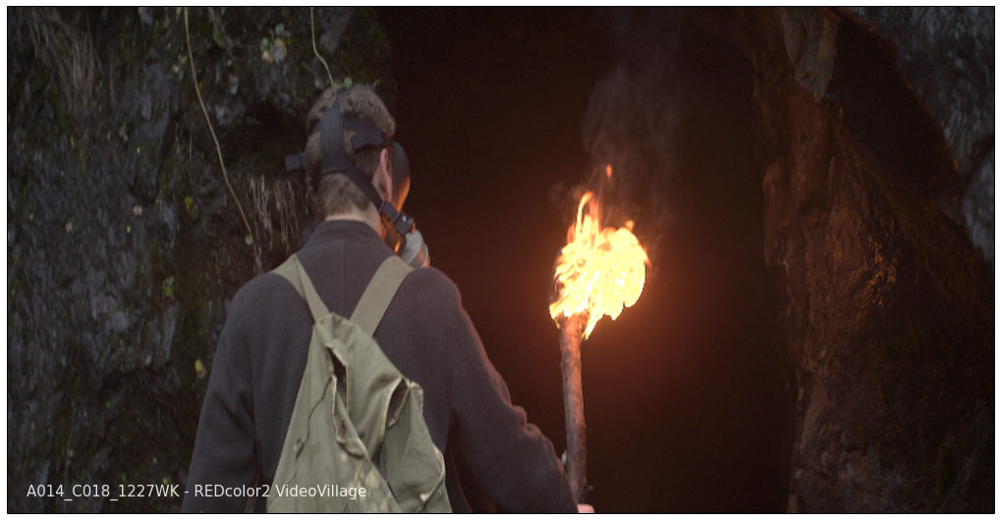

*                                                                             *
*   A014_C018_1227WK                                                          *
*                                                                             *
*   rmse   : 0.00427193351218                                                 *
*                                                                             *
*   rmse VV: 0.0356891819613                                                  *
*                                                                             *




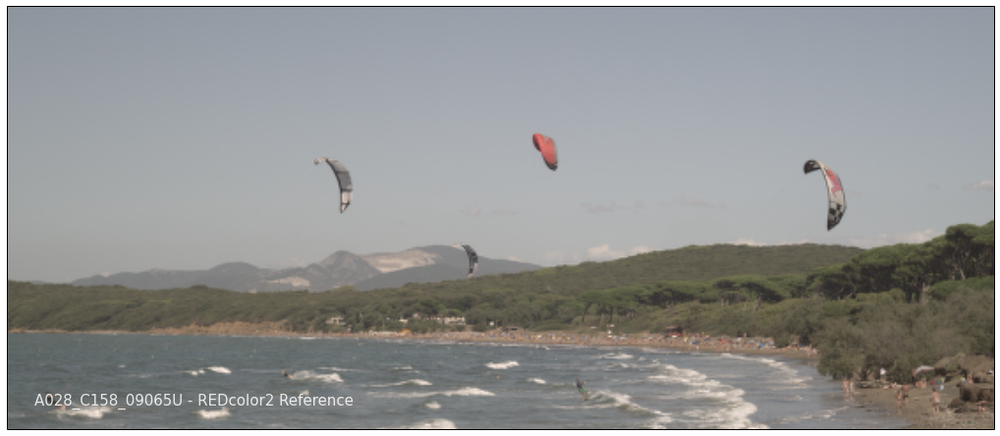

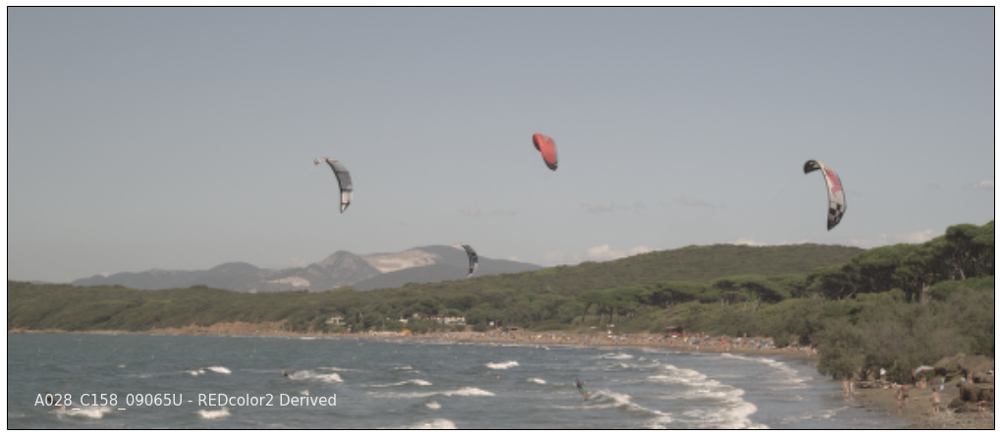

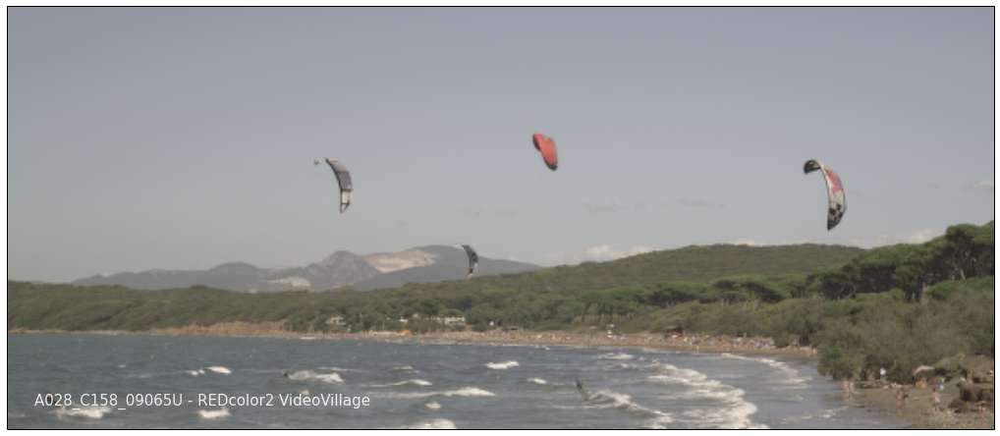

*                                                                             *
*   A028_C158_09065U                                                          *
*                                                                             *
*   rmse   : 0.000140445755814                                                *
*                                                                             *
*   rmse VV: 0.00260492349001                                                 *
*                                                                             *




In [7]:
RGB_colourspace_RMSE('REDcolor2')

### REDcolor3 Colourspace RMSE

The *REDcolor3 Reference* images below have been generated within [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/) using the following *Read* node settings:

- decode resolution: EighthGood
- color space: REDcolor3
- gamma space: Half Float Linear

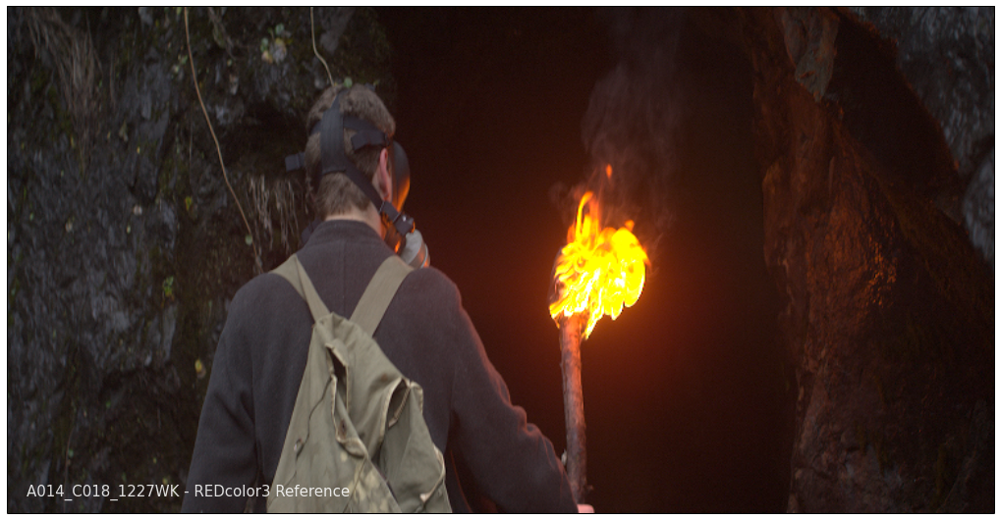

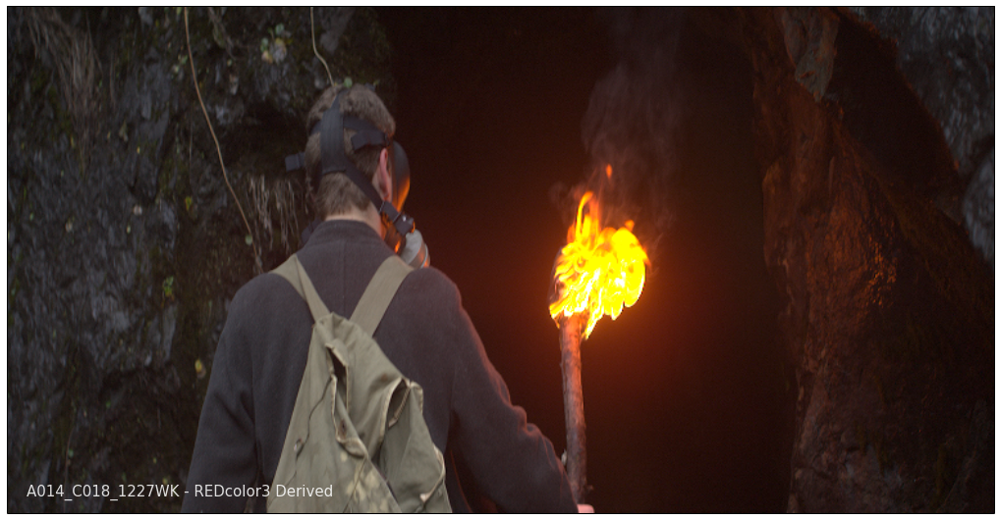

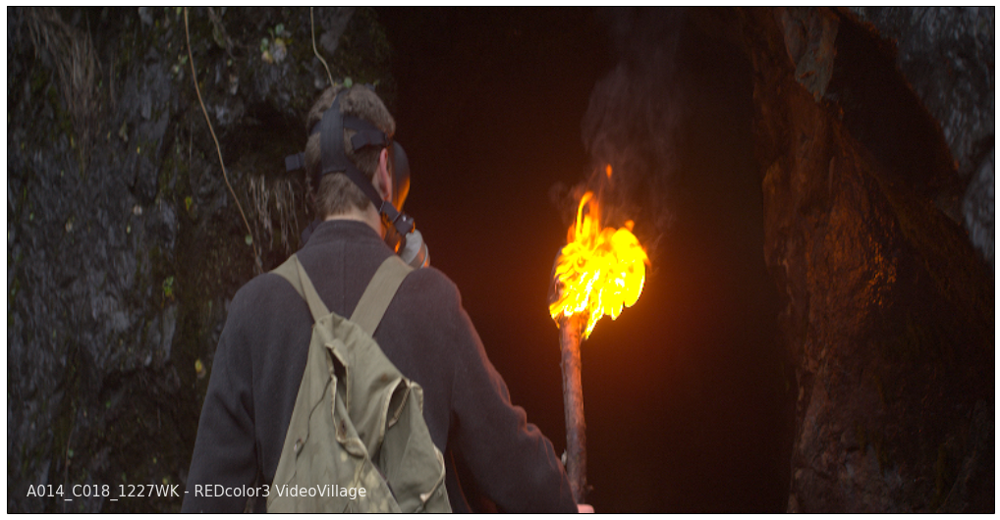

*                                                                             *
*   A014_C018_1227WK                                                          *
*                                                                             *
*   rmse   : 0.000236643177169                                                *
*                                                                             *
*   rmse VV: 0.0196475588311                                                  *
*                                                                             *




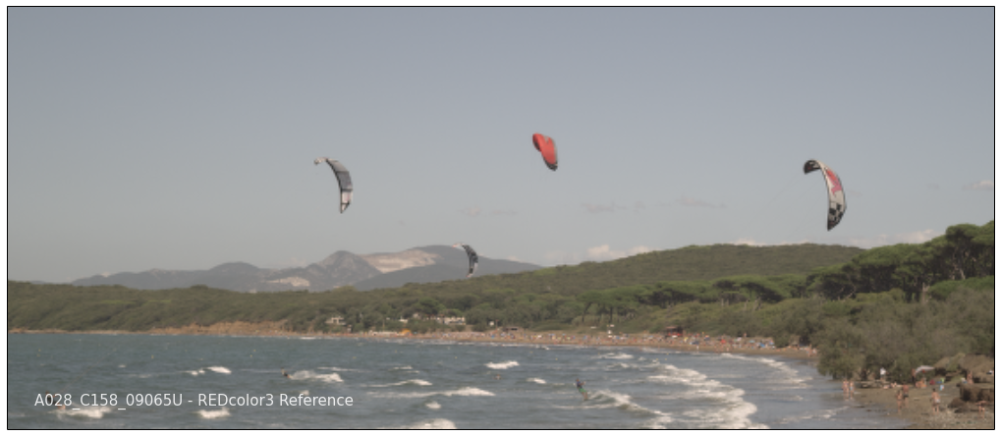

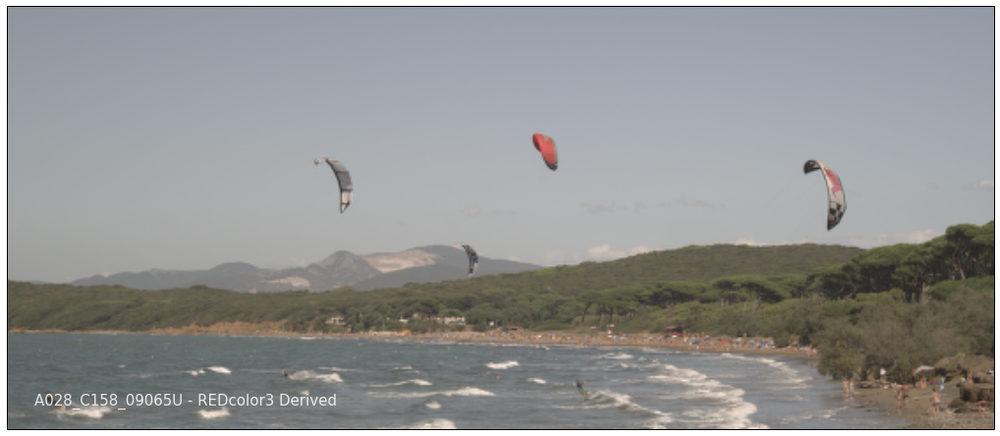

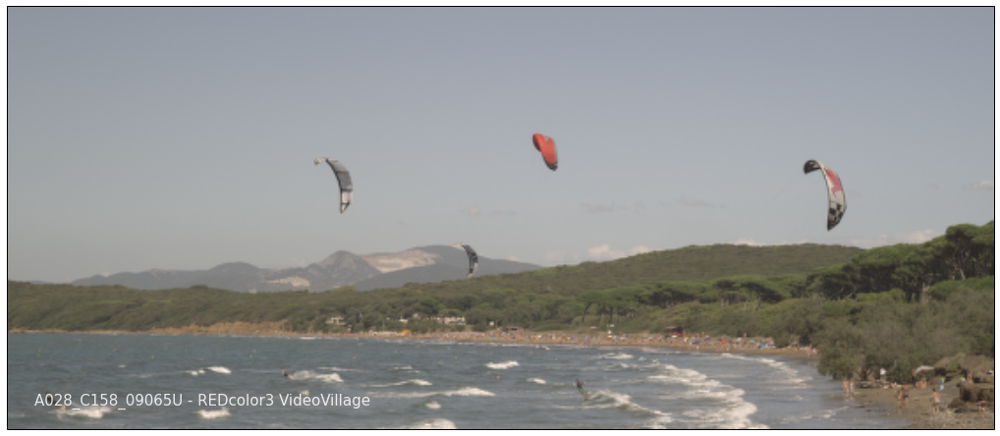

*                                                                             *
*   A028_C158_09065U                                                          *
*                                                                             *
*   rmse   : 0.000119341395285                                                *
*                                                                             *
*   rmse VV: 0.00142447503055                                                 *
*                                                                             *




In [8]:
RGB_colourspace_RMSE('REDcolor3')

### DRAGONcolor Colourspace RMSE

The *DRAGONcolor Reference* images below have been generated within [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/) using the following *Read* node settings:

- decode resolution: EighthGood
- color space: DRAGONcolor
- gamma space: Half Float Linear

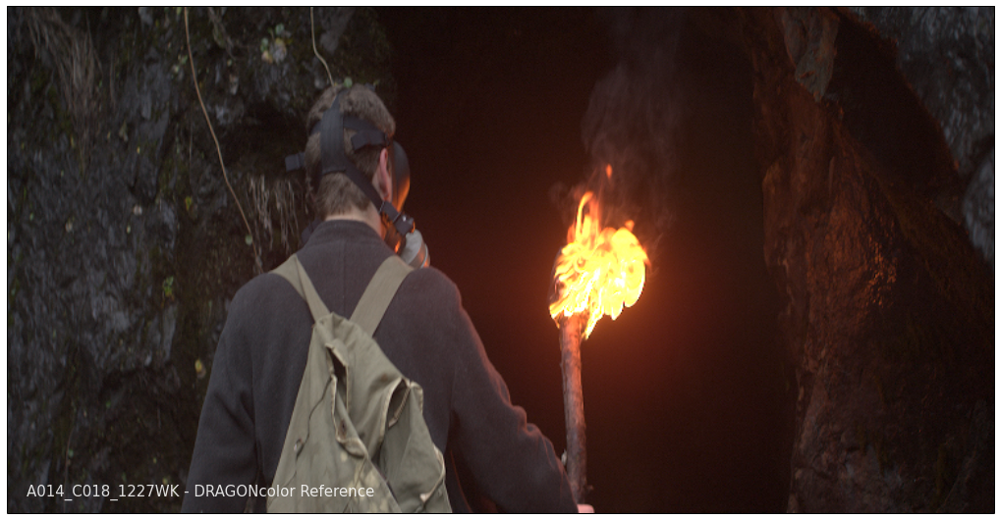

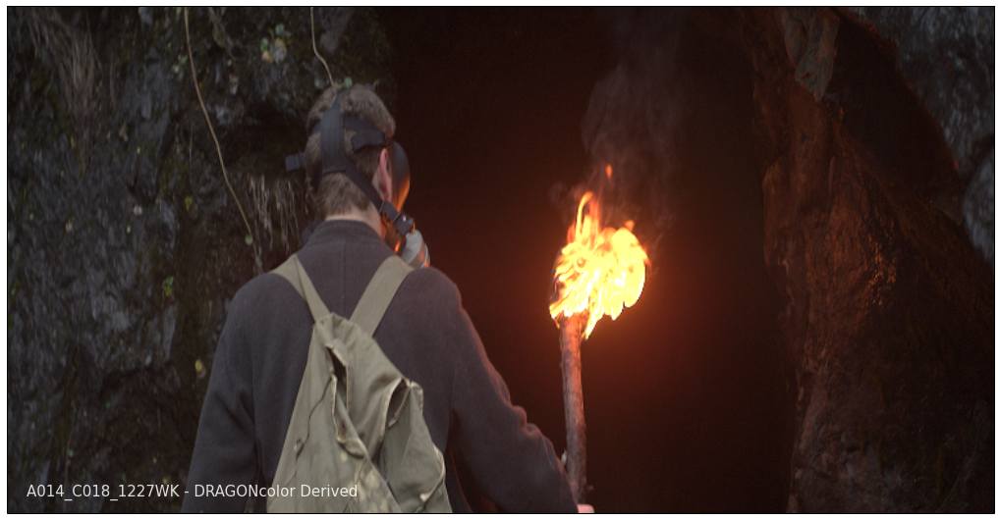

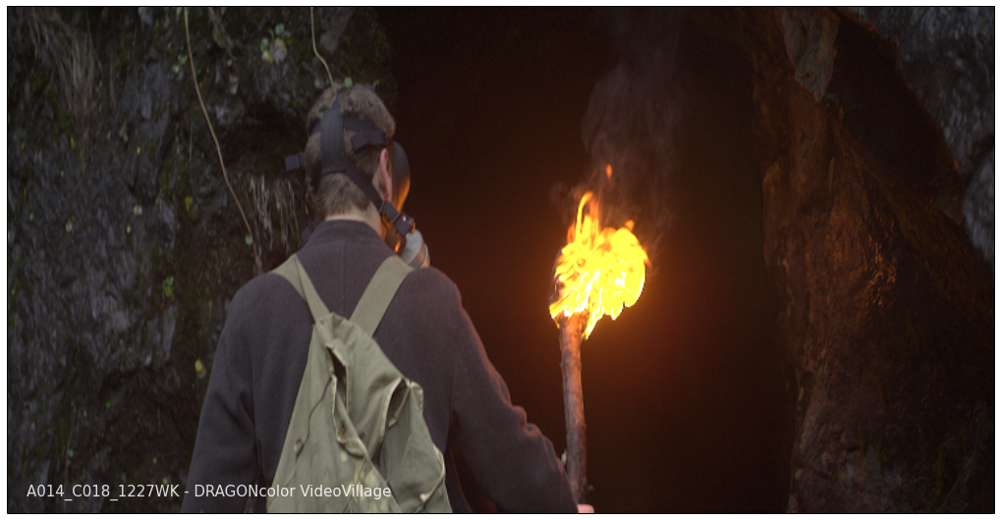

*                                                                             *
*   A014_C018_1227WK                                                          *
*                                                                             *
*   rmse   : 0.00425039768166                                                 *
*                                                                             *
*   rmse VV: 0.0653893340819                                                  *
*                                                                             *




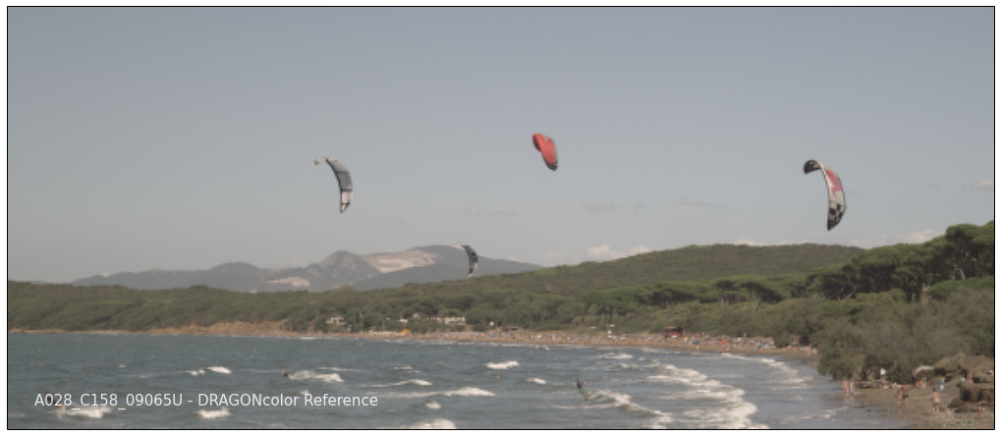

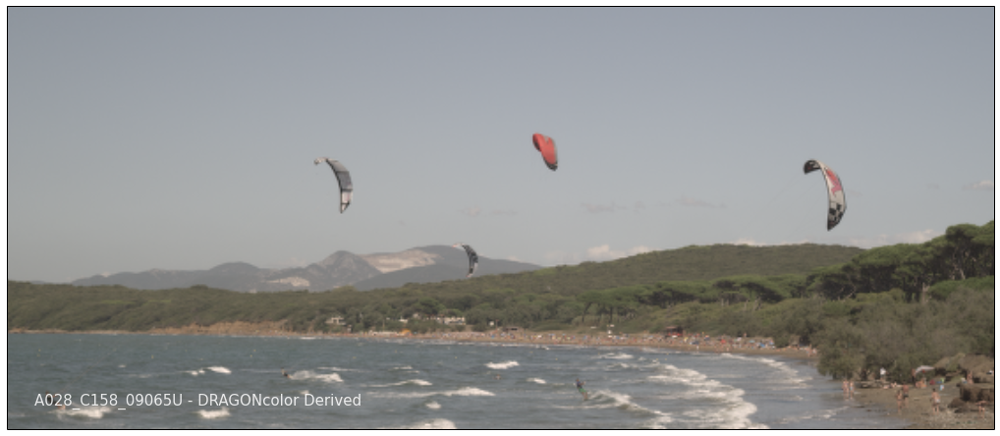

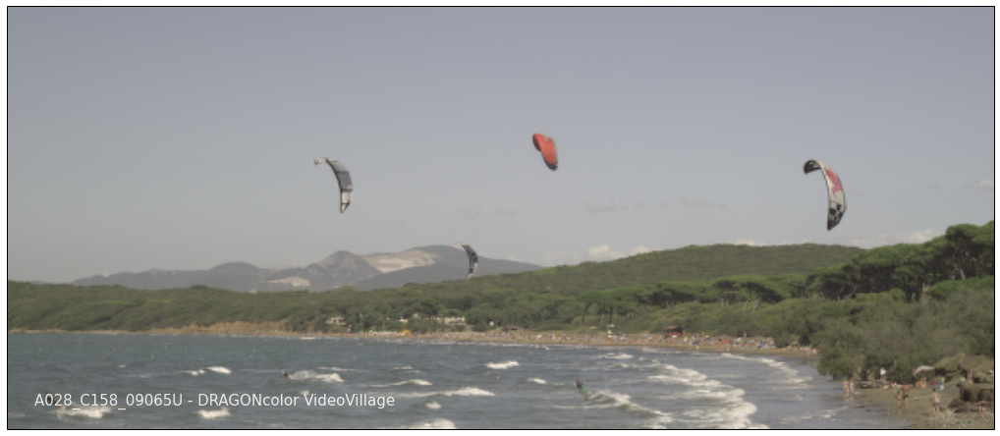

*                                                                             *
*   A028_C158_09065U                                                          *
*                                                                             *
*   rmse   : 0.000138549424244                                                *
*                                                                             *
*   rmse VV: 0.00473443391133                                                 *
*                                                                             *




In [9]:
RGB_colourspace_RMSE('DRAGONcolor')

## REDCINE-X PRO CIE XYZ Reference

The *CIE XYZ Reference* image below has been generated within [REDCINE-X PRO](http://www.red.com/products/redcine-x) with the following settings and exported to OpenEXR at 1/4 clip resolution:

- Color Space: REDcolor4
- Gamma Space: REDlogFilm

Within [The Foundry Nuke](https://www.thefoundry.co.uk/products/nuke/), the publicised *REDcolor4* colourspace to *ACES2065-1* colourspace matrix and [the known matrix](https://github.com/colour-science/colour/blob/develop/colour/models/dataset/aces.py#L135) converting from *ACES2065-1* colourspace to *CIE XYZ* colourspace were used to convert from *REDcolor4* colourspace to *CIE XYZ* colourspace.

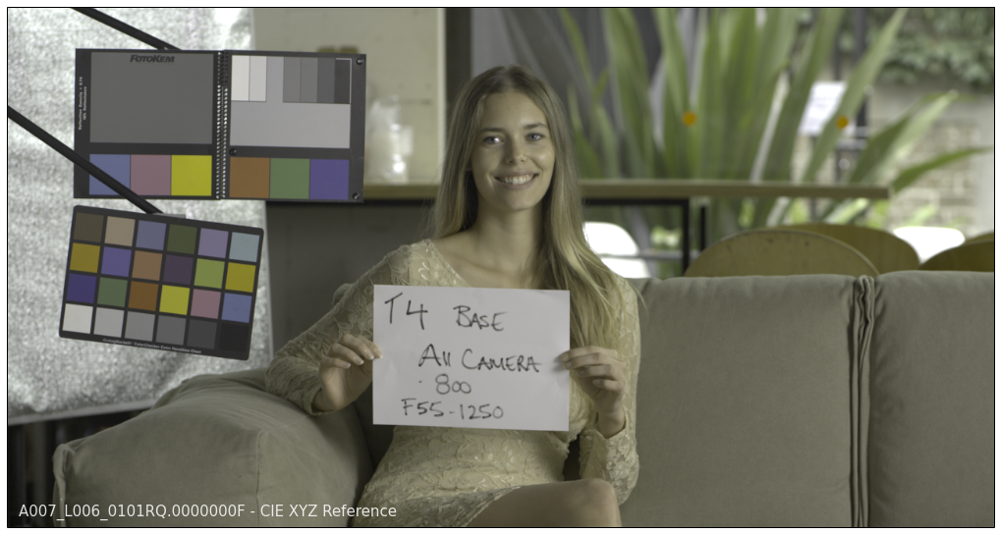

In [10]:
IMAGES_BASENAME = ('A007_L006_0101RQ.0000000F',)

for basename in IMAGES_BASENAME:
    image_plot(OECF(colour.read_image(
    'resources/images/red/{0}_XYZ.exr'.format(basename))),
               label='{0} - CIE XYZ Reference'.format(basename))

## REDcolour4 Colourspace RMSE

The *REDcolour4 Reference* image below has been generated within [REDCINE-X PRO](http://www.red.com/products/redcine-x) with the following settings and exported to OpenEXR at 1/4 clip resolution:

- Color Space: REDcolor4
- Gamma Space: REDlogFilm

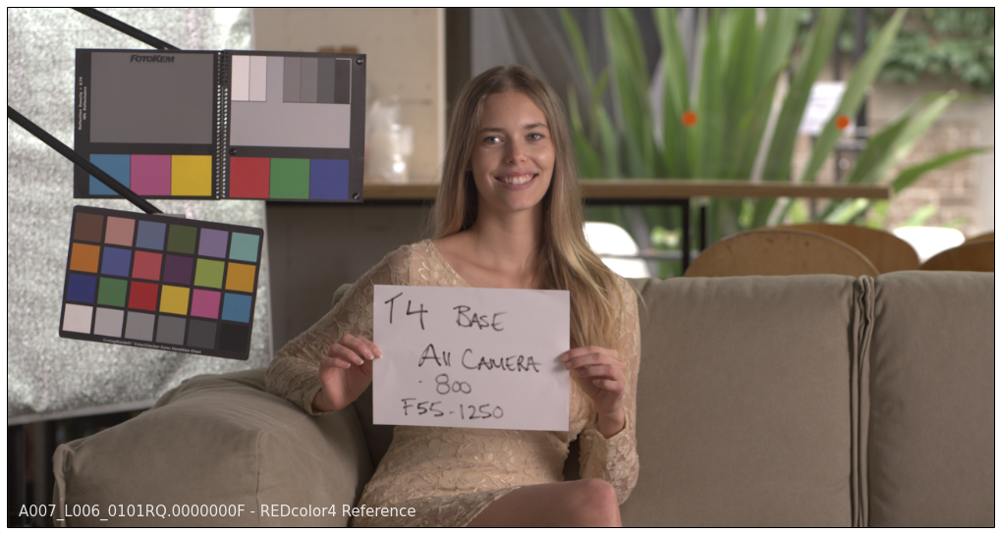

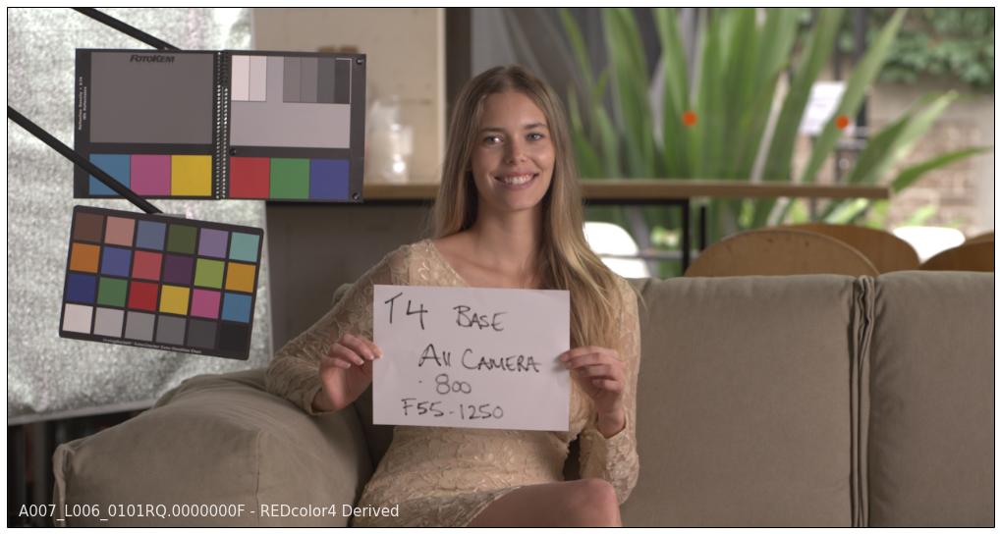

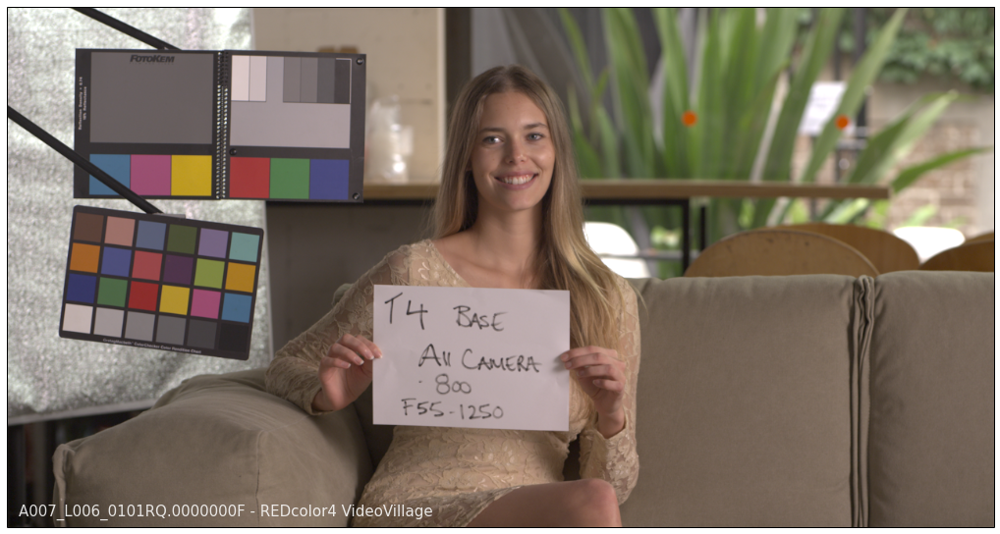

*                                                                             *
*   A007_L006_0101RQ.0000000F                                                 *
*                                                                             *
*   rmse   : 0.000128151411996                                                *
*                                                                             *
*   rmse VV: 0.00169705576908                                                 *
*                                                                             *




In [11]:
RGB_colourspace_RMSE('REDcolor4')

## DRAGONcolour2 Colourspace RMSE

The *DRAGONcolour2 Reference* image below has been generated within [REDCINE-X PRO](http://www.red.com/products/redcine-x) with the following settings and exported to OpenEXR at 1/4 clip resolution:

- Color Space: DRAGONcolour2
- Gamma Space: REDlogFilm

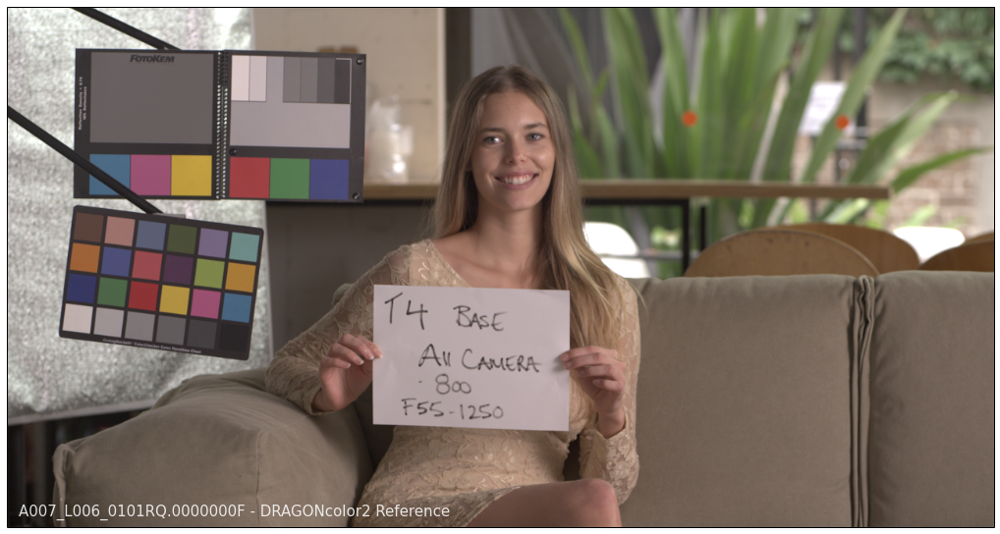

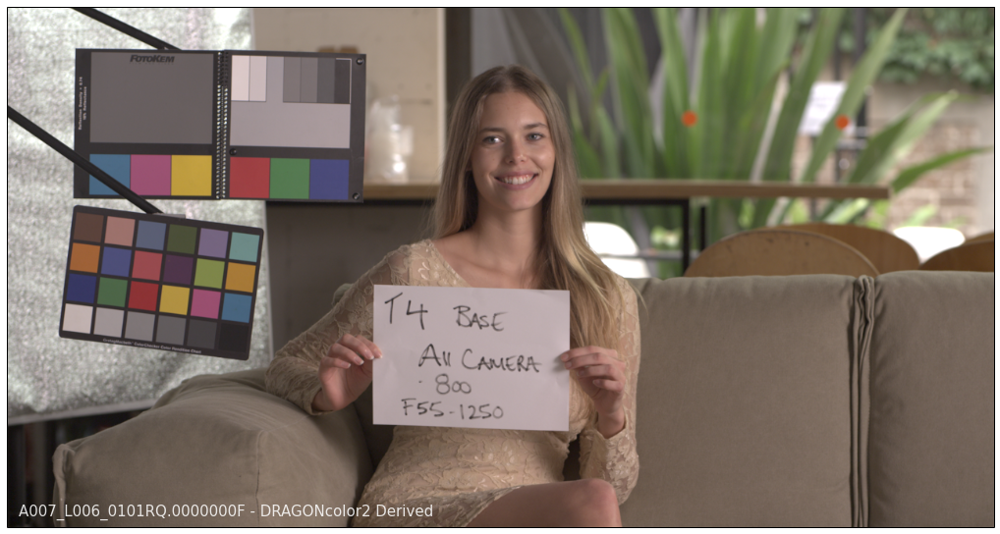

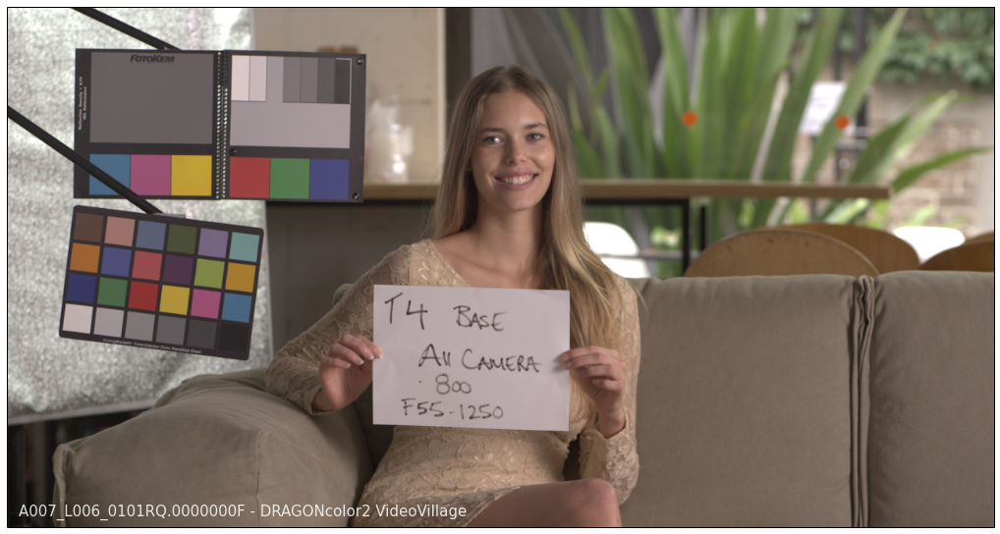

*                                                                             *
*   A007_L006_0101RQ.0000000F                                                 *
*                                                                             *
*   rmse   : 0.000151539790651                                                *
*                                                                             *
*   rmse VV: 0.0014625456282                                                  *
*                                                                             *




In [12]:
RGB_colourspace_RMSE('DRAGONcolor2')

## RED Colourspaces Primaries

In [13]:
from IPython.display import HTML

def HTML_format_matrix(M, precision=7):
    # Handling whitepoint tuples.
    M = np.asarray(M)
    if M.ndim == 1:
        M = M.reshape(1, -1)

    html = '<table class="matrix-table">'
    shape = M.shape
    for i in range(shape[0]):
        html += '<tr class="matrix-row">'
        for j in range(shape[1]):
            v = M[i][j]
            pretty = '{{: 0.{}f}}'.format(precision).format(
                v) if precision is not None else v
            html += '<td class="matrix-column">{0}</td>'.format(pretty)
        html += '</tr>'
    html += '</table>'
    return html


def html_format_colourspaces(colourspaces):
    html = ('<table class="table">'
            '<thead class="table-header">'
            '<tr class="table-row-header-group">'
            '<th class="table-canton"></th>'
            '<th class="table-row-header">Primaries</th>'
            '<th class="table-row-header">Whitepoint</th>'
#             '<th class="table-row-header">Illuminant</th>'
#             '<th class="table-row-header">XYZ to RGB</th>'
#             '<th class="table-row-header">RGB to XYZ</th>'
            '</tr>'
            '</thead>'
            '<tbody>')
    for i, colourspace in enumerate(colourspaces):
        html += '<tr class="table-row {0}">'.format(
            'table-row-odd' if i % 2 == 0 else '')
        html += '<td class="table-data-header">{0}</td>'.format(
            colourspace.name)
        html += '<td class="table-data">{0}</td>'.format(
            HTML_format_matrix(colourspace.primaries, precision=None))
        html += '<td class="table-data text-align-center vertical-align-top">{0}</td>'.format(
            HTML_format_matrix(colourspace.whitepoint, precision=None))
#         html += '<td class="table-data text-align-center vertical-align-top">{0}</td>'.format(
#             colourspace.illuminant)
#         html += '<td class="table-data">{0}</td>'.format(
#             HTML_format_matrix(colourspace.XYZ_to_RGB_matrix, precision=None))
#         html += '<td class="table-data">{0}</td>'.format(
#             HTML_format_matrix(colourspace.RGB_to_XYZ_matrix, precision=None))
        html += '</tr>'
    html += ('<tbody>'
             '</table>')
    return html


HTML(html_format_colourspaces(
    (v for k, v in sorted(RED_COLOURSPACES.items()))))

In [14]:
HTML("<style>\n{0}\n</style>".format(open('style.css','r').read()))

## References

1. <a href="#back_reference_1">^<a> <a name="reference_1"></a>Trieu, T. (2015). Private Discussion with Mansencal, T.